In [1]:
from sklearn.metrics import roc_curve
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.metrics import precision_recall_curve, roc_curve
from sklearn.metrics import auc
from sklearn.metrics import average_precision_score
from sklearn.metrics.pairwise import cosine_similarity as cosine
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from neo4j import GraphDatabase
import cv2
from glob import glob
import json

In [29]:
URI = "neo4j://localhost:7687"  
USERNAME = "neo4j"            
PASSWORD = "Tai123321"     

In [30]:
def get_neo4j_driver():
    return GraphDatabase.driver(URI, auth=(USERNAME, PASSWORD))

In [55]:
def query_images_any(sorted_classes):
    image_ids = []
    with get_neo4j_driver().session() as session:
                query = """
                    WITH $classes AS classes
                    MATCH (img:Image)
                    WHERE ANY(class IN classes WHERE class IN[(img)-[:HAS_A]->(cls:Class) | cls.name])
                    RETURN img.image_Id AS image_id
                """
                result = session.run(query, classes=list(sorted_classes))
                for record in result:
                    if record["image_id"] not in image_ids:
                        image_ids.append(record["image_id"])
    if image_ids:
        return image_ids
    else:
        return None

In [2]:
bovw = json.load(open("./new_bovw.json"))
print(len(bovw))

97273


In [3]:
copy_bovw = bovw.copy()
print(bovw[0])

{'ID': 'c52e4b7b42cd5427', 'Histogram': '[1.0, 0.29457244, 0.15516745, 0.26048854, 0.05792806, 0.026807811, -3.3589913e-09, 0.08570918, 1.0, 0.36185396, 0.2202106, 0.35515213, 0.083555646, 0.09081593, 5.8435035e-09, 0.0047498266, 1.0, 0.23618941, 0.2295012, 0.42980692, 0.2710422, 0.1482627, -1.0795702e-09, 0.03834669]', 'Objects': [{'Object_Id': 1, 'Class': 'Human face', 'Bbox': '[238.3320770263672, 256.9740295410156, 412.8487854003906, 434.0414123535156]', 'Conf': 0.8552523255348206}, {'Object_Id': 2, 'Class': 'Human face', 'Bbox': '[531.6046142578125, 161.68077087402344, 723.92041015625, 408.900146484375]', 'Conf': 0.8415064215660095}, {'Object_Id': 3, 'Class': 'Human face', 'Bbox': '[0.0, 86.51470184326172, 54.5564079284668, 233.65185546875]', 'Conf': 0.7054436802864075}, {'Object_Id': 4, 'Class': 'Woman', 'Bbox': '[0.0, 69.27558898925781, 240.3115692138672, 653.28955078125]', 'Conf': 0.6104355454444885}, {'Object_Id': 5, 'Class': 'Hat', 'Bbox': '[166.29629516601562, 30.09423828125,

In [4]:
bovw_dict = {img['ID']: img for img in copy_bovw}
print(len(bovw_dict))


97273


In [5]:
def get_image_profile_from_bovw(image_id, sorted_classes, tmp_bovw):
    for image in tmp_bovw:
        if image["ID"] == image_id:
            conf = 0
            for obj in image["Objects"]:
                if obj["Class"] in sorted_classes and obj["Conf"] > conf:
                    conf = obj["Conf"]
            histogram = image["Histogram"]
            #convert histogram to a list from a string
            histogram = histogram[1:-1].split(",")
            histogram = [float(i) for i in histogram]
            image_profile = {
                "ID": image["ID"],
                "features": histogram,
                "conf": conf
            }
            tmp_bovw.remove(image)
            return image_profile
    return None

In [6]:
def get_image_profile_fast_optimized(image_id, classes_set, data_dict):
    image_data = data_dict.get(image_id) 

    if image_data:
        max_conf = 0
        objects = image_data.get("Objects", [])

        for obj in objects:
            obj_conf = obj.get("Conf", 0)
            if obj.get("Class") in classes_set and obj_conf > max_conf:
                max_conf = obj_conf

        image_profile = {
            "ID": image_id,
            "conf": max_conf
        }
        return image_profile
    else:
        return None

In [7]:
def get_image_histogram(image_id):
    for image in bovw:
        if image["ID"] == image_id:
            return image["Histogram"]
    return None

def compute_histogram(image_path, bins=8):
    # Load the image
    image = cv2.imread(image_path)
    if image is None:
        raise ValueError("Image not found or unable to load.")

    # Split into B, G, R channels
    channels = cv2.split(image)

    # Empty list to store histogram values
    hist = []

    # Compute histogram for each channel
    for channel in channels:
        channel_hist = cv2.calcHist([channel], [0], None, [bins], [0, 256])
        # Normalize to range [0, 1]
        cv2.normalize(channel_hist, channel_hist, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX)
        # Flatten and add to the list
        hist.extend(channel_hist.flatten())

    return hist

In [8]:
import ast
ground_truth = pd.read_csv("./pre_re_cal/ground_truth_top_level.csv")

In [9]:
ground_truth["Description"] = ground_truth["Description"].apply(ast.literal_eval)
ground_truth["Top Level Classes"] = ground_truth["Top Level Classes"].apply(ast.literal_eval)

In [10]:
print(ground_truth.head())

            ImageID                                        Description  \
0  0000253ea4ecbf19  [Carnivore, Human leg, Mammal, Plant, Tree, Hu...   
1  0000271195f2c007  [Human eye, Headphones, Boy, Person, Human mou...   
2  0000286a5c6a3eb5  [Human eye, Sunglasses, Shorts, Person, Human ...   
3  00003bfccf5f36c2  [Person, Lantern, Chair, Table, Tree, Furnitur...   
4  000045257f66b9e2  [Boy, Person, Cowboy hat, Hat, Fedora, Human b...   

                                   Top Level Classes  
0                [Plant, Mammal, Animal, Human body]  
1         [Headphones, Person, Human body, Clothing]  
2  [Human body, Clothing, Person, Animal, Persona...  
3  [Window, Lantern, Furniture, Plant, Building, ...  
4  [Human body, Hat, Clothing, Trousers, Plant, F...  


In [11]:
#remove all row that ImageID is not in bovw
ground_truth = ground_truth[ground_truth["ImageID"].isin([image["ID"] for image in bovw])]
ground_truth = ground_truth.reset_index(drop=True)
print(len(ground_truth))

97273


In [12]:
ground_truth_processed = ground_truth.copy()
ground_truth_processed = ground_truth_processed.drop_duplicates(subset=['ImageID'], keep='first')
ground_truth_processed.set_index('ImageID', inplace=True)
print(len(ground_truth_processed))

97273


In [13]:
print(ground_truth_processed.head())

                                                        Description  \
ImageID                                                               
0000253ea4ecbf19  [Carnivore, Human leg, Mammal, Plant, Tree, Hu...   
0000286a5c6a3eb5  [Human eye, Sunglasses, Shorts, Person, Human ...   
00003bfccf5f36c2  [Person, Lantern, Chair, Table, Tree, Furnitur...   
000045257f66b9e2  [Boy, Person, Cowboy hat, Hat, Fedora, Human b...   
0000530c47410921                    [Toy, Bird, Duck, Tire, Animal]   

                                                  Top Level Classes  
ImageID                                                              
0000253ea4ecbf19                [Plant, Mammal, Animal, Human body]  
0000286a5c6a3eb5  [Human body, Clothing, Person, Animal, Persona...  
00003bfccf5f36c2  [Window, Lantern, Furniture, Plant, Building, ...  
000045257f66b9e2  [Human body, Hat, Clothing, Trousers, Plant, F...  
0000530c47410921                     [Auto part, Toy, Bird, Animal]  


In [14]:
child_map = pd.read_csv("./pre_re_cal/child_map.csv")
print(child_map.head())

        Parent                                              Child
0     Aircraft               ['Helicopter', 'Airplane', 'Rocket']
1       Animal  ['Shellfish', 'Bird', 'Invertebrate', 'Mammal'...
2    Auto part  ['Vehicle registration plate', 'Wheel', 'Seat ...
3  Baked goods  ['Pretzel', 'Cookie', 'Muffin', 'Bagel', 'Brea...
4         Ball  ['Football', 'Cricket ball', 'Volleyball (Ball...


In [15]:
child_map["Child"] = child_map["Child"].apply(ast.literal_eval)

In [16]:
def get_child_classes(parent_class):
    child_classes = []
    child_classes.append(parent_class)
    for index, row in child_map.iterrows():
        if row["Parent"] == parent_class:
            child_classes.extend(row["Child"])
    return child_classes

In [17]:
def check_image_fast_indexed(image_id, parent_class, indexed_df):
    try:
        row_data = indexed_df.loc[image_id]
        top_classes = row_data['Top Level Classes']
        if parent_class in top_classes:
            return 1
        else:
            return 0
    except KeyError:
        return 0
    except TypeError as e:
        print(f"Type error checking image {image_id}: {e}. Data: {row_data if 'row_data' in locals() else 'N/A'}")
        return 0

In [18]:
def get_image_id(image_path):
    return image_path.split("/")[-1].split(".")[0].split("\\")[-1]

In [19]:
def get_y_true_and_y_pred(classes):
    child_classes = get_child_classes(classes)
    # child_classes = [classes]
    y_true = []
    y_pred = []
    print(len(ground_truth_processed))
    i=0
    image_ids = ground_truth_processed.index.tolist()
    for image_id in image_ids:
        # Check if the image is in the ground truth
        y_true.append(check_image_fast_indexed(image_id, classes, ground_truth_processed))
        # Get the image profile from the BOVW
        image_profile = get_image_profile_fast_optimized(image_id, set(child_classes), bovw_dict)
        if image_profile is not None:
            conf = image_profile["conf"]
            y_pred.append(conf)
        else:
            y_pred.append(0)
        print(f"{i}. {image_id} - {y_true[-1]} - {y_pred[-1]}")
        i+=1
    return y_true, y_pred

In [20]:
classes = child_map["Parent"].unique()
print(len(classes))

76


In [31]:
#remove first 31 + 10 classes
classes = classes[10:]
print(len(classes))

5


In [32]:
i=0
for class_name in classes:
    if i == 10:
        break
    print(f"Processing class: {class_name}")
    i+=1
    y_true, y_pred = get_y_true_and_y_pred(class_name)
    if y_true is None or y_pred is None:
        print(f"No images found for class: {class_name}")
        continue
    else:
        #save to csv
        df = pd.DataFrame({"y_true": y_true, "y_pred": y_pred})
        df.to_csv(f"./true_pred_result_all_db_all_cls/{class_name}_true_pred.csv", index=False)

Processing class: Turtle
97273
0. 0000253ea4ecbf19 - 0 - 0
1. 0000286a5c6a3eb5 - 0 - 0
2. 00003bfccf5f36c2 - 0 - 0
3. 000045257f66b9e2 - 0 - 0
4. 0000530c47410921 - 0 - 0
5. 00005bf623ff1ac2 - 0 - 0
6. 00009cadede2ed69 - 0 - 0
7. 0000a54dd13a67a7 - 0 - 0
8. 0000d01325742829 - 0 - 0
9. 000123034b89f3df - 0 - 0
10. 000132a014faadaf - 0 - 0
11. 000151d10b95b4d3 - 0 - 0
12. 0001771c86cadcd6 - 0 - 0
13. 0001a2f47097ee27 - 0 - 0
14. 0001a646b2a73e94 - 0 - 0
15. 0001e27f4b156f49 - 0 - 0
16. 0001ff6b8fc43d43 - 0 - 0
17. 000234a17c124f75 - 0 - 0
18. 000256419f7c57d8 - 0 - 0
19. 00028af07aea0ea7 - 0 - 0
20. 0002ac503f923a95 - 0 - 0
21. 0002c8fa13a79365 - 0 - 0
22. 0002d304de1414f0 - 0 - 0
23. 0002d5c6b40edcd4 - 0 - 0
24. 00030b8c7652041d - 0 - 0
25. 00033bc5b18e08ad - 0 - 0
26. 00039573fc999278 - 0 - 0
27. 0003dd7fb653f91f - 0 - 0
28. 000428518eb0ef73 - 0 - 0
29. 00047b40c7b664bb - 0 - 0
30. 00047bab5f8f23b7 - 0 - 0
31. 0004c6db7a801c3f - 0 - 0
32. 0004d295cfb46842 - 0 - 0
33. 0005133a0bf2ecc1 -

In [21]:
classes_profiles = []
classes_profiles_half_db = []
for class_name in classes:    
    df_classes = pd.read_csv(f"./true_pred_result_all_db_all_cls/{class_name}_true_pred.csv")
    y_true, y_pred = df_classes["y_true"].tolist(), df_classes["y_pred"].tolist()
    y_true = np.array(y_true)
    y_pred = np.array(y_pred)
    # Sort y_pred in descending order and get the indices
    # Get the top 80000 indices
    
    sorted_indices = np.argsort(y_pred)[::-1]
    y_true_half = y_true[sorted_indices[:100]]
    y_pred_half = y_pred[sorted_indices[:100]]
    class_profile = {
        "class_name": class_name,
        "y_true": y_true,
        "y_pred": y_pred
    }
    class_profile_half = {
        "class_name": class_name,
        "y_true": y_true_half,
        "y_pred": y_pred_half
    }
    classes_profiles.append(class_profile)
    classes_profiles_half_db.append(class_profile_half)

In [22]:
metrics_profiles = []

for class_profile in classes_profiles:
    class_name = class_profile["class_name"]
    y_true = class_profile["y_true"]
    y_pred = class_profile["y_pred"]
    print(f"Processing class: {class_name}")
    precision, recall, thresholds = precision_recall_curve(y_true, y_pred)
    average_precision = average_precision_score(y_true, y_pred)
    print(f"Average precision: {average_precision:.2f}")

    copy_y_true = y_true.copy()
    copy_y_pred = y_pred.copy()

    # Convert y_pred to binary using a threshold of 0.5
    threshold = 0.4
    y_pred_binary = [1 if pred >= threshold else 0 for pred in copy_y_pred]
    f1 = f1_score(copy_y_true, y_pred_binary)
    precision_scr = precision_score(copy_y_true, y_pred_binary)
    recall_scr = recall_score(copy_y_true, y_pred_binary)
    print(f"Precision: {precision_scr:.2f}")
    print(f"Recall: {recall_scr:.2f}")
    print(f"F1 Score: {f1:.2f}")

    roc_curve_data = roc_curve(copy_y_true, copy_y_pred)
    fpr, tpr, thresholds = roc_curve_data
    roc_auc = auc(fpr, tpr)
    print(f"ROC AUC: {roc_auc:.2f}")
    metric_profile = {
        "class_name": class_name,
        "average_precision": average_precision,
        "precision": precision,
        "recall": recall,
        "f1_score": f1,
        "roc_auc": roc_auc,
        "fpr": fpr,
        "tpr": tpr,
        "precision_scores": precision_scr,
        "recall_scores": recall_scr,
    }
    metrics_profiles.append(metric_profile)
    

Processing class: Aircraft
Average precision: 0.89
Precision: 0.88
Recall: 0.91
F1 Score: 0.90
ROC AUC: 0.97
Processing class: Animal
Average precision: 0.26
Precision: 0.95
Recall: 0.15
F1 Score: 0.27
ROC AUC: 0.59
Processing class: Auto part
Average precision: 0.66
Precision: 0.74
Recall: 0.62
F1 Score: 0.67
ROC AUC: 0.88
Processing class: Baked goods
Average precision: 0.61
Precision: 0.62
Recall: 0.58
F1 Score: 0.60
ROC AUC: 0.88
Processing class: Ball
Average precision: 0.61
Precision: 0.51
Recall: 0.78
F1 Score: 0.61
ROC AUC: 0.91
Processing class: Bathroom accessory
Average precision: 0.35
Precision: 0.72
Recall: 0.18
F1 Score: 0.28
ROC AUC: 0.76
Processing class: Bear
Average precision: 0.74
Precision: 0.70
Recall: 0.76
F1 Score: 0.73
ROC AUC: 0.91
Processing class: Bed
Average precision: 0.16
Precision: 0.19
Recall: 0.52
F1 Score: 0.28
ROC AUC: 0.85
Processing class: Beetle
Average precision: 0.39
Precision: 0.22
Recall: 0.88
F1 Score: 0.35
ROC AUC: 0.94
Processing class: Bird

In [23]:
metrics_profiles_half_db = []

for class_profile in classes_profiles_half_db:
    class_name = class_profile["class_name"]
    y_true = class_profile["y_true"]
    y_pred = class_profile["y_pred"]
    print(f"Processing class: {class_name}")
    precision, recall, thresholds = precision_recall_curve(y_true, y_pred)
    average_precision = average_precision_score(y_true, y_pred)
    print(f"Average precision: {average_precision:.2f}")

    copy_y_true = y_true.copy()
    copy_y_pred = y_pred.copy()

    # Convert y_pred to binary using a threshold of 0.5
    threshold = 0.4
    y_pred_binary = [1 if pred >= threshold else 0 for pred in copy_y_pred]
    f1 = f1_score(copy_y_true, y_pred_binary)
    print(f"F1 Score: {f1:.2f}")
    precision_scr = precision_score(copy_y_true, y_pred_binary)
    recall_scr = recall_score(copy_y_true, y_pred_binary)

    roc_curve_data = roc_curve(copy_y_true, copy_y_pred)
    fpr, tpr, thresholds = roc_curve_data
    roc_auc = auc(fpr, tpr)
    print(f"ROC AUC: {roc_auc:.2f}")
    metric_profile = {
        "class_name": class_name,
        "average_precision": average_precision,
        "precision": precision,
        "recall": recall,
        "f1_score": f1,
        "roc_auc": roc_auc,
        "fpr": fpr,
        "tpr": tpr,
        "precision_scores": precision_scr,
        "recall_scores": recall_scr,
    }
    metrics_profiles_half_db.append(metric_profile)
    

Processing class: Aircraft
Average precision: 0.97
F1 Score: 0.98
ROC AUC: 0.51
Processing class: Animal
Average precision: 1.00
F1 Score: 1.00
ROC AUC: nan
Processing class: Auto part
Average precision: 0.99
F1 Score: 0.98
ROC AUC: 0.73
Processing class: Baked goods
Average precision: 0.96
F1 Score: 0.96
ROC AUC: 0.68
Processing class: Ball
Average precision: 0.85
F1 Score: 0.90
ROC AUC: 0.51
Processing class: Bathroom accessory
Average precision: 0.67
F1 Score: 0.46
ROC AUC: 0.78
Processing class: Bear
Average precision: 0.96
F1 Score: 0.91
ROC AUC: 0.82
Processing class: Bed
Average precision: 0.51
F1 Score: 0.21
ROC AUC: 0.68
Processing class: Beetle
Average precision: 0.46
F1 Score: 0.41
ROC AUC: 0.62
Processing class: Bird
Average precision: 0.97
F1 Score: 0.97
ROC AUC: 0.65
Processing class: Boat
Average precision: 0.73
F1 Score: 0.37
ROC AUC: 0.84
Processing class: Building
Average precision: 0.99
F1 Score: 0.99
ROC AUC: 0.63
Processing class: Car
Average precision: 0.55
F1 Sco

C:\Users\Admin\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_ranking.py:1179: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  warnings.warn(
C:\Users\Admin\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_ranking.py:1179: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  warnings.warn(
C:\Users\Admin\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_ranking.py:1179: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  warnings.warn(
C:\Users\Admin\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_ranking.py:1179: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  warnings.warn(
C:\Users\Admin\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_ranking.py:1179: UndefinedMetricWarning: No negative samples in y_true, false

F1 Score: 0.95
ROC AUC: 0.54
Processing class: Medical equipment
Average precision: 0.76
F1 Score: 0.68
ROC AUC: 0.94
Processing class: Moths and butterflies
Average precision: 0.92
F1 Score: 0.94
ROC AUC: 0.56
Processing class: Musical instrument
Average precision: 1.00
F1 Score: 1.00
ROC AUC: nan
Processing class: Office supplies
Average precision: 0.96
F1 Score: 0.95
ROC AUC: 0.68
Processing class: Pastry
Average precision: 0.55
F1 Score: 0.53
ROC AUC: 0.82
Processing class: Person
Average precision: 1.00
F1 Score: 0.99
ROC AUC: 0.99
Processing class: Personal care
Average precision: 0.98
F1 Score: 0.98
ROC AUC: 0.60
Processing class: Plant
Average precision: 1.00
F1 Score: 1.00
ROC AUC: nan
Processing class: Plumbing fixture
Average precision: 0.97
F1 Score: 0.96
ROC AUC: 0.69
Processing class: Racket
Average precision: 0.88
F1 Score: 0.85
ROC AUC: 0.74
Processing class: Reptile
Average precision: 0.99
F1 Score: 0.98
ROC AUC: 0.80
Processing class: Sandwich
Average precision: 0.87


C:\Users\Admin\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_ranking.py:1179: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  warnings.warn(
C:\Users\Admin\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_ranking.py:1179: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  warnings.warn(
C:\Users\Admin\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_ranking.py:1179: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  warnings.warn(


In [24]:
#remove all classes that have any metric < 0.5
metrics_profiles = [profile for profile in metrics_profiles if profile["average_precision"] >= 0.7 and profile["f1_score"] >= 0.7 and profile["roc_auc"] >= 0.7]
print(len(metrics_profiles))

21


In [25]:
#remove all classes that have any metric < 0.5
metrics_profiles_half_db = [profile for profile in metrics_profiles if profile["average_precision"] >= 0.7 and profile["f1_score"] >= 0.7 and profile["roc_auc"] >= 0.7]
print(len(metrics_profiles_half_db))

21


In [84]:
#count total number of classes
total_classes = 0
for class_profile in metrics_profiles:
    cls = class_profile["class_name"]
    child_cls = get_child_classes(cls)
    total_classes += len(child_cls)
print(f"Total classes: {total_classes}")

Total classes: 92


In [26]:
f1_avg = 0
for metric_profile in metrics_profiles:
    f1_avg += metric_profile["f1_score"]
f1_avg /= len(metrics_profiles)
print(f"F1 Score Average: {f1_avg:.2f}")

F1 Score Average: 0.80


In [27]:
f1_avg_half_db = 0
for metric_profile in metrics_profiles_half_db:
    f1_avg_half_db += metric_profile["f1_score"]
f1_avg_half_db /= len(metrics_profiles_half_db)
print(f"F1 Score Average Half DB: {f1_avg_half_db:.2f}")

F1 Score Average Half DB: 0.80


In [28]:
mean_avg_pre = np.mean([profile["average_precision"] for profile in metrics_profiles])
print(f"Mean Average Precision: {mean_avg_pre:.2f}")

Mean Average Precision: 0.81


In [29]:
mean_avg_pre_half_db = np.mean([profile["average_precision"] for profile in metrics_profiles_half_db])
print(f"Mean Average Precision Half DB: {mean_avg_pre_half_db:.2f}")

Mean Average Precision Half DB: 0.81


In [30]:
mean_precision = np.mean([profile["precision_scores"] for profile in metrics_profiles])
print(f"Mean Precision: {mean_precision:.2f}")
mean_recall = np.mean([profile["recall_scores"] for profile in metrics_profiles])
print(f"Mean Recall: {mean_recall:.2f}")

Mean Precision: 0.84
Mean Recall: 0.77


In [31]:
mean_precision_half_db = np.mean([profile["precision_scores"] for profile in metrics_profiles_half_db])
print(f"Mean Precision Half DB: {mean_precision_half_db:.2f}")
mean_recall_half_db = np.mean([profile["recall_scores"] for profile in metrics_profiles_half_db])
print(f"Mean Recall Half DB: {mean_recall_half_db:.2f}")

Mean Precision Half DB: 0.84
Mean Recall Half DB: 0.77


In [251]:
from scipy.interpolate import make_interp_spline

In [33]:
#draw roc curve and precision recall curve for all classes in one figure
def draw_roc_curve(metrics_profiles):
    plt.figure(figsize=(10, 6))
    for metric_profile in metrics_profiles:
        class_name = metric_profile["class_name"]
        fpr = metric_profile["fpr"]
        tpr = metric_profile["tpr"]
        roc_auc = metric_profile["roc_auc"]
        # plt.plot(fpr, tpr, label=f'{class_name} (AUC = {roc_auc:.2f})')
        plt.plot(fpr,tpr)
    plt.plot([0, 1], [0, 1], 'k--', label='Random')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve')
    # plt.legend()
    plt.grid()
    plt.show()

def draw_precision_recall_curve(metrics_profiles):
    plt.figure(figsize=(10, 6))
    for metric_profile in metrics_profiles:
        class_name = metric_profile["class_name"]
        precision = metric_profile["precision"]
        recall = metric_profile["recall"]
        average_precision = metric_profile["average_precision"]
        # plt.plot(recall, precision, label=f'{class_name} (AP = {average_precision:.2f})')
        plt.plot(recall, precision)
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    # plt.legend()
    plt.grid()
    plt.show()

def draw_combine_two_curve_in_subplot(metrics_profiles):
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    for metric_profile in metrics_profiles:
        class_name = metric_profile["class_name"]
        fpr = metric_profile["fpr"]
        tpr = metric_profile["tpr"]
        roc_auc = metric_profile["roc_auc"]
        plt.plot(fpr, tpr)
    plt.plot([0, 1], [0, 1], 'k--', label='Random')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve')
    plt.legend()
    plt.grid()
    plt.subplot(1, 2, 2)
    for metric_profile in metrics_profiles:
        class_name = metric_profile["class_name"]
        precision = metric_profile["precision"]
        recall = metric_profile["recall"]
        average_precision = metric_profile["average_precision"]
        #sorting plot by recall but then add to precision so that it will be sorted like recall
        sort_idx = np.argsort(recall)
        recall_sorted = recall[sort_idx]
        precision_sorted = precision[sort_idx]

        unique_recalls = []
        unique_precisions = []
        seen_recalls = set()

        for recall, precision in zip(recall_sorted, precision_sorted):
            if recall not in seen_recalls:
                unique_recalls.append(recall)
                unique_precisions.append(precision)
                seen_recalls.add(recall)

        unique_recalls = np.array(unique_recalls)
        unique_precisions = np.array(unique_precisions)

        # Apply spline interpolation
        if len(unique_recalls) > 3:  # Spline requires at least 2 unique points, but 3 is safer for cubic
            xnew = np.linspace(unique_recalls.min(), unique_recalls.max(), 300)
            spl = make_interp_spline(unique_recalls, unique_precisions, k=3)
            precision_smooth = spl(xnew)

        plt.plot(xnew, precision_smooth)
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.legend()
    plt.grid()
    plt.tight_layout()
    plt.show()

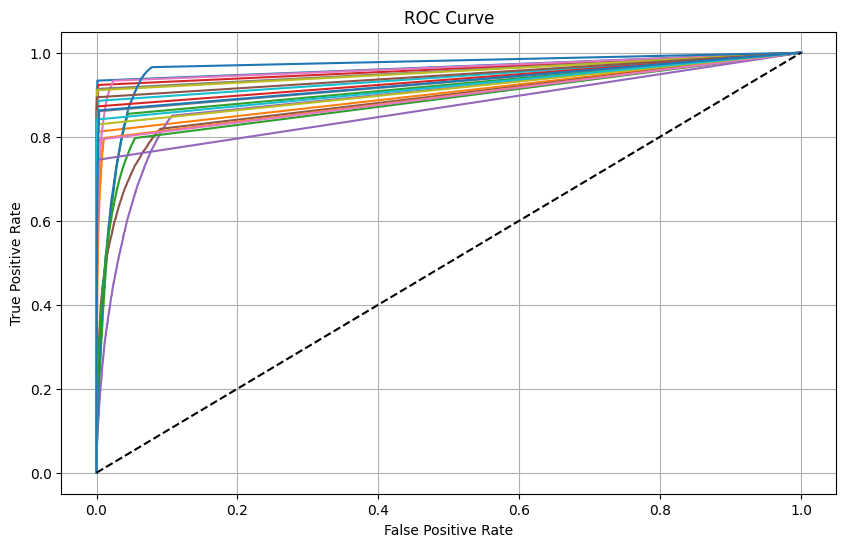

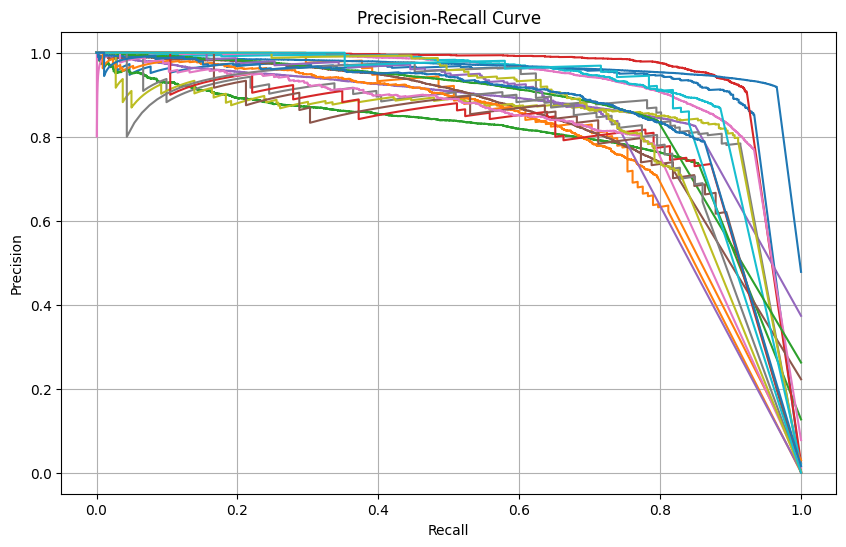

In [34]:
draw_roc_curve(metrics_profiles)
draw_precision_recall_curve(metrics_profiles)

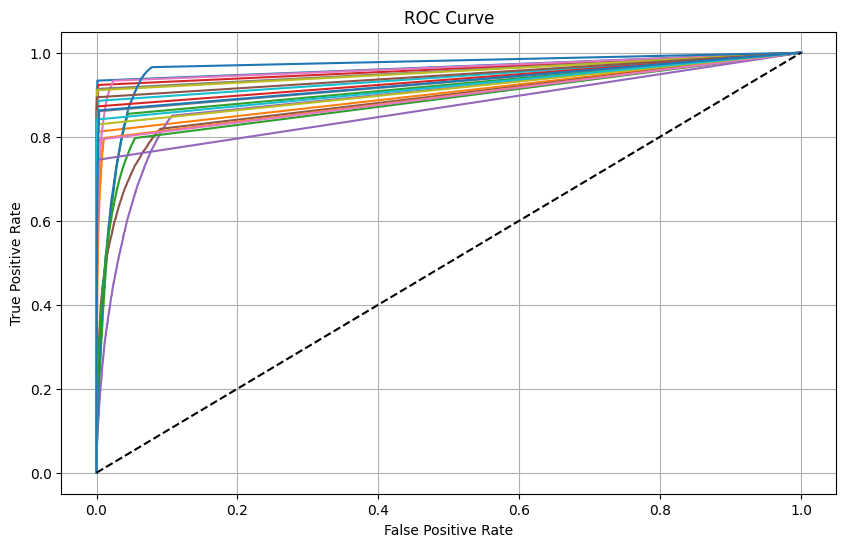

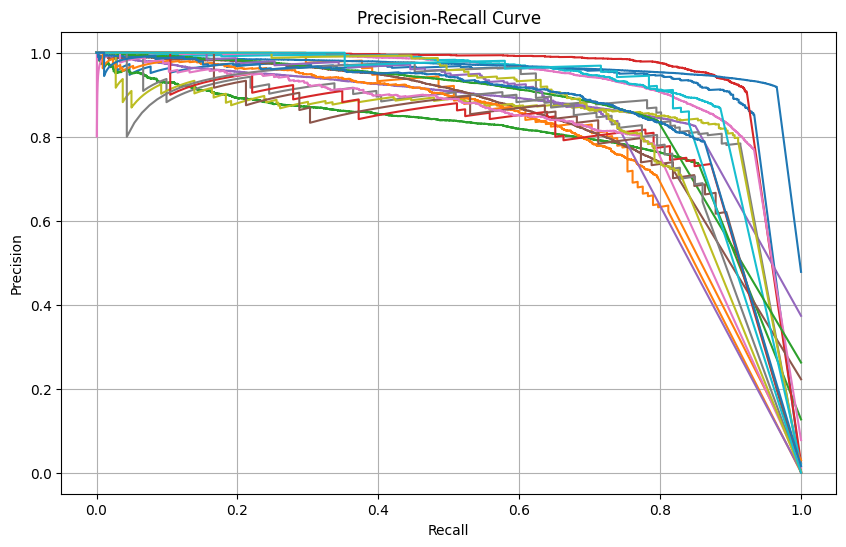

In [35]:
draw_roc_curve(metrics_profiles_half_db)
draw_precision_recall_curve(metrics_profiles_half_db)


In [27]:
from sklearn.utils import resample

In [28]:
data = list(zip(copy_y_true, copy_y_pred))
data = np.array(data)
# Separate majority and minority classes
majority = data[data[:, 0] == 1]
minority = data[data[:, 0] == 0]

# Upsample minority class
minority_upsampled = resample(minority,
                              replace=True,     # sample with replacement
                              n_samples=len(majority),    # to match majority class
                              random_state=42) # reproducible results
# Combine majority class with upsampled minority class
upsampled = np.vstack((majority, minority_upsampled))
# Convert to DataFrame
upsampled_df = pd.DataFrame(upsampled, columns=['y_true', 'y_pred'])
# Separate features and target
X = upsampled_df['y_pred'].values.reshape(-1, 1)
y = upsampled_df['y_true'].values

# calculate the ROC curve
fpr, tpr, thresholds = roc_curve(y, X)
# calculate the AUC
roc_auc = auc(fpr, tpr)
print(f"ROC AUC: {roc_auc:.2f}")

ROC AUC: 0.75


In [112]:
#resample all classes
resampled_classes = []
for class_profile in class_profile:
    data = list(zip(class_profile["y_true"], class_profile["y_pred"]))
    data = np.array(data)
    # Separate majority and minority classes
    majority = data[data[:, 0] == 1]
    minority = data[data[:, 0] == 0]
    # Upsample minority class
    minority_upsampled = resample(minority,
                                  replace=True,     # sample with replacement
                                  n_samples=len(majority),    # to match majority class
                                  random_state=42) # reproducible results
    # Combine majority class with upsampled minority class
    upsampled = np.vstack((majority, minority_upsampled))
    # Convert to DataFrame
    upsampled_df = pd.DataFrame(upsampled, columns=['y_true', 'y_pred'])
    # Separate features and target
    X = upsampled_df['y_pred'].values.reshape(-1, 1)
    y = upsampled_df['y_true'].values
    
    #save into array
    resampled_classes.append({
        "class_name": class_profile["class_name"],
        "y_pred": X,
        "y_true": y
    })


TypeError: string indices must be integers, not 'str'

In [91]:
print(child_map.head())
child_map["Parent"][0]

        Parent                                              Child
0     Aircraft                     [Helicopter, Airplane, Rocket]
1       Animal  [Shellfish, Bird, Invertebrate, Mammal, Reptil...
2    Auto part  [Vehicle registration plate, Wheel, Seat belt,...
3  Baked goods    [Pretzel, Cookie, Muffin, Bagel, Bread, Pastry]
4         Ball  [Football, Cricket ball, Volleyball (Ball), Te...


'Aircraft'

In [95]:
# Method A: Using explode (Often faster for large DataFrames if 'Child' contains lists)
child_col_for_mapping = 'Child'
try:
    print("Attempting to build map using explode...")
    # Temporarily handle potential empty lists or non-list items gracefully
    temp_map = child_map.dropna(subset=[child_col_for_mapping]) \
                      .explode(child_col_for_mapping)
    # Create the dictionary {Child -> Parent}
    child_to_parent_lookup = pd.Series(
        temp_map['Parent'].values,
        index=temp_map[child_col_for_mapping]
    ).to_dict()
    print("Map built successfully using explode.")

except Exception as e:
    print(f"Warning: Explode method failed ({e}). Falling back to iterrows.")
    # Method B: Using iterrows (Fallback, or if 'Child' isn't list-like)
    child_to_parent_lookup = {}
    for index, row in child_map.iterrows():
        parent = row['Parent']
        children = row[child_col_for_mapping]
        if isinstance(children, list): # Ensure it's a list before iterating
            for child in children:
                # This overwrites if a child appears under multiple parents,
                # keeping the last one encountered.
                child_to_parent_lookup[child] = parent
        # else: you might want to handle non-list entries if they occur
    print("Map built using iterrows.")

print(f"Created lookup map with {len(child_to_parent_lookup)} child entries.")

Attempting to build map using explode...
Map built successfully using explode.
Created lookup map with 525 child entries.


In [97]:
def map_cls_to_parent_fast(cls, lookup_map):
    """
    Looks up the parent of a class using a pre-computed dictionary.
    Args:
        cls (str): The child class name.
        lookup_map (dict): The pre-computed {child: parent} dictionary.
    Returns:
        str or None: The parent class name, or None if the child is not found.
    """
    # Dictionary .get() is average O(1) time complexity - very fast!
    return lookup_map.get(cls)

In [99]:
from collections import defaultdict

# Initialize defaultdict with default value 0 for integers
classes_count_dd = defaultdict(int)

for image in bovw:
    # Use .get("Objects", []) for safety in case "Objects" key is missing
    for obj in image.get("Objects", []):
        # Use obj.get("Class") for safety in case "Class" key is missing
        class_name = obj.get("Class")
        #map back to parent class
        parent_class = map_cls_to_parent_fast(class_name, child_to_parent_lookup)
        if parent_class:
            class_name = parent_class
        if class_name is not None: # Only count if class name exists
            classes_count_dd[class_name] += 1

In [100]:
len(classes_count_dd)

121

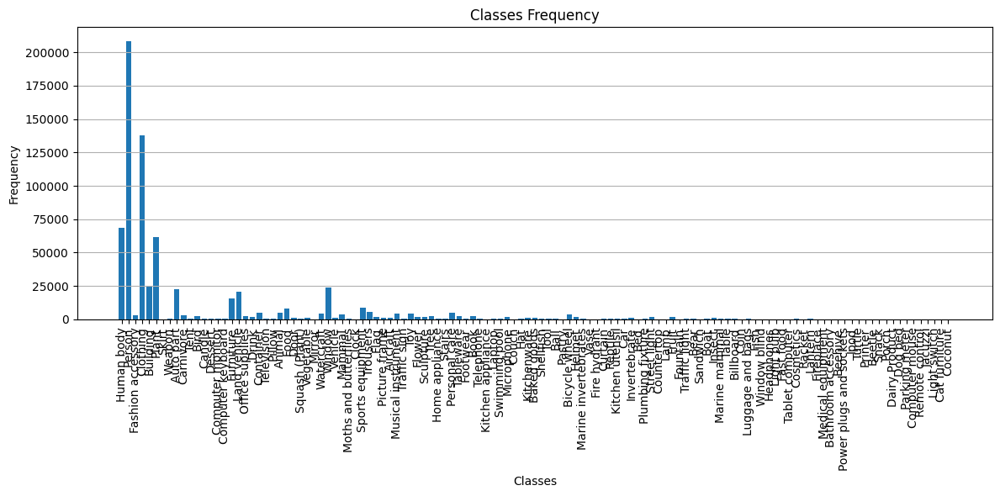

In [101]:
#plot the classes count
plt.figure(figsize=(12, 6))
plt.bar(classes_count_dd.keys(), classes_count_dd.values())
plt.xticks(rotation=90)
plt.xlabel('Classes')
plt.ylabel('Frequency')
plt.title('Classes Frequency')
plt.grid(axis='y')
plt.tight_layout()
plt.show()
